## Libraries 

In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
 
import warnings
warnings.filterwarnings('ignore')

## Reading Data

In [10]:
# from google.colab import files
# uploaded = files.upload()

In [11]:
# import io
# df = pd.read_excel(io.BytesIO(uploaded['Data_Train.xlsx']))

In [12]:
# from google.colab import drive

# drive.mount('/content/drive')

In [13]:
# !pip install openpyxl

In [14]:
df = pd.read_excel('Data_Train.xlsx',engine='openpyxl')

df.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302


## Creating Report 

In [15]:
# pip install dataprep

In [16]:
from dataprep.eda import create_report

NumExpr defaulting to 8 threads.


  0%|          | 0/1009 [00:00<?, ?it/s]

DataPrep Report
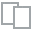
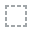
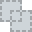
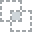
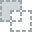
...
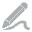
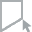
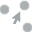
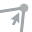
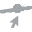

In [17]:
create_report(df)

## Inference :
After running the above code you will get a report as shown in the above figure. This report contains various sections or tabs.  ‘Overview’ section of this report provides us with all the basic information of the data we are using. For the current data we are using we got the following information:

* Number of variables = 11
* Number of rows = 10683
* Number of categorical type of feature = 10
* Number of numerical type of feature = 1
* Duplicate rows = 220

* We saw there are on;y few missing values present  from the report . 
* Lets check them manually.

## Data Preparation

In [18]:
df.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302


In [19]:
df.shape

(10683, 11)

## Inference:
Dataset has 11 variables and 10683 records. Lets summarize these variables.

* Airline: Name of the airline used for traveling

* Date_of_Journey: Date at which a person traveled

* Source: Starting location of flight

* Destination: Ending location of flight

* Route: This contains information on starting and ending location of the journey in the standard format used by airlines.

* Dep_Time: Departure time of flight from starting location

* Arrival_Time: Arrival time of flight at destination

* Duration: Duration of flight in hours/minutes

* Total_Stops: Number of total stops flight took before landing at the destination.

* Additional_Info: Shown any additional information about a flight

* Price: Price of the flight

## Handling Missing Values

In [20]:
df.isna().sum().to_frame('Missing Count')

,Missing Count
Airline,0
Date_of_Journey,0
Source,0
Destination,0
Route,1
Dep_Time,0
Arrival_Time,0
Duration,0
Total_Stops,1
Additional_Info,0


* we can simply drop these rows from dataframe.

In [21]:
df.dropna(axis=0,inplace= True)

* Let us again check the missing values. 

In [22]:
df.isna().sum().to_frame('Missing Count')

,Missing Count
Airline,0
Date_of_Journey,0
Source,0
Destination,0
Route,0
Dep_Time,0
Arrival_Time,0
Duration,0
Total_Stops,0
Additional_Info,0


* No missing values are left to be checked.

In [23]:
df.dtypes.to_frame('Data type')

,Data type
Airline,object
Date_of_Journey,object
Source,object
Destination,object
Route,object
Dep_Time,object
Arrival_Time,object
Duration,object
Total_Stops,object
Additional_Info,object


## Handling Date and Time Variables

We can extract ‘Journey_day’ and ‘Journey_Month’ from the ‘Date_of_Journey’ variable. ‘Journey day’ shows the day of the month on which the journey was started.

In [24]:
df["Journey_day"] = pd.to_datetime(df.Date_of_Journey, format="%d/%m/%Y").dt.day

df["Journey_month"] = pd.to_datetime(df["Date_of_Journey"], format = "%d/%m/%Y").dt.month

df.drop(["Date_of_Journey"], axis = 1, inplace = True)

In [25]:
df.head()

,Airline,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,Journey_day,Journey_month
0,IndiGo,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897,24,3
1,Air India,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662,1,5
2,Jet Airways,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882,9,6
3,IndiGo,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218,12,5
4,IndiGo,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302,1,3


Similarly, we can extract ‘Departure_Hour’ and ‘Departure_Minute’ as well as ‘Arrival_Hour and ‘Arrival_Minute’ from ‘Dep_Time’ and ‘Arrival_Time’ variables respectively.

In [26]:
df["Dep_hour"] = pd.to_datetime(df["Dep_Time"]).dt.hour

df["Dep_min"] = pd.to_datetime(df["Dep_Time"]).dt.minute

df.drop(["Dep_Time"], axis = 1, inplace = True)

In [27]:
df.head()

,Airline,Source,Destination,Route,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,Journey_day,Journey_month,Dep_hour,Dep_min
0,IndiGo,Banglore,New Delhi,BLR → DEL,01:10 22 Mar,2h 50m,non-stop,No info,3897,24,3,22,20
1,Air India,Kolkata,Banglore,CCU → IXR → BBI → BLR,13:15,7h 25m,2 stops,No info,7662,1,5,5,50
2,Jet Airways,Delhi,Cochin,DEL → LKO → BOM → COK,04:25 10 Jun,19h,2 stops,No info,13882,9,6,9,25
3,IndiGo,Kolkata,Banglore,CCU → NAG → BLR,23:30,5h 25m,1 stop,No info,6218,12,5,18,5
4,IndiGo,Banglore,New Delhi,BLR → NAG → DEL,21:35,4h 45m,1 stop,No info,13302,1,3,16,50


In [28]:
df["Arrival_hour"] = pd.to_datetime(df.Arrival_Time).dt.hour

df["Arrival_min"] = pd.to_datetime(df.Arrival_Time).dt.minute

df.drop(["Arrival_Time"], axis = 1, inplace = True)

In [29]:
df.head()

,Airline,Source,Destination,Route,Duration,Total_Stops,Additional_Info,Price,Journey_day,Journey_month,Dep_hour,Dep_min,Arrival_hour,Arrival_min
0,IndiGo,Banglore,New Delhi,BLR → DEL,2h 50m,non-stop,No info,3897,24,3,22,20,1,10
1,Air India,Kolkata,Banglore,CCU → IXR → BBI → BLR,7h 25m,2 stops,No info,7662,1,5,5,50,13,15
2,Jet Airways,Delhi,Cochin,DEL → LKO → BOM → COK,19h,2 stops,No info,13882,9,6,9,25,4,25
3,IndiGo,Kolkata,Banglore,CCU → NAG → BLR,5h 25m,1 stop,No info,6218,12,5,18,5,23,30
4,IndiGo,Banglore,New Delhi,BLR → NAG → DEL,4h 45m,1 stop,No info,13302,1,3,16,50,21,35


We also have duration information on the ‘Duration’ variable. This variable contains both duration hours and minutes information combined.

#### Custom function to extract hours and minutes from duration 

In [30]:
def get_duration(x):
    x=x.split(' ')
    hours=0
    mins=0
    if len(x)==1:
        x=x[0]
        if x[-1]=='h':
            hours=int(x[:-1])
        else:
            mins=int(x[:-1])
    else:
        hours=int(x[0][:-1])
        mins=int(x[1][:-1])
    return hours,mins

In [31]:
df['Duration_hours']=df.Duration.apply(lambda x:get_duration(x)[0])

df['Duration_mins']=df.Duration.apply(lambda x:get_duration(x)[1])

df.drop(["Duration"], axis = 1, inplace = True)

In [32]:
df.head()

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,Journey_day,Journey_month,Dep_hour,Dep_min,Arrival_hour,Arrival_min,Duration_hours,Duration_mins
0,IndiGo,Banglore,New Delhi,BLR → DEL,non-stop,No info,3897,24,3,22,20,1,10,2,50
1,Air India,Kolkata,Banglore,CCU → IXR → BBI → BLR,2 stops,No info,7662,1,5,5,50,13,15,7,25
2,Jet Airways,Delhi,Cochin,DEL → LKO → BOM → COK,2 stops,No info,13882,9,6,9,25,4,25,19,0
3,IndiGo,Kolkata,Banglore,CCU → NAG → BLR,1 stop,No info,6218,12,5,18,5,23,30,5,25
4,IndiGo,Banglore,New Delhi,BLR → NAG → DEL,1 stop,No info,13302,1,3,16,50,21,35,4,45


## Handling Categorical Data

In [33]:
df_cat = df.select_dtypes(include='object')
df_cat.columns.to_list()

['Airline', 'Source', 'Destination', 'Route', 'Total_Stops', 'Additional_Info']

Airline, Source, Destination, Route, Total_Stops, Additional_info are the categorical variables we have in our data. Let’s handle each one by one.

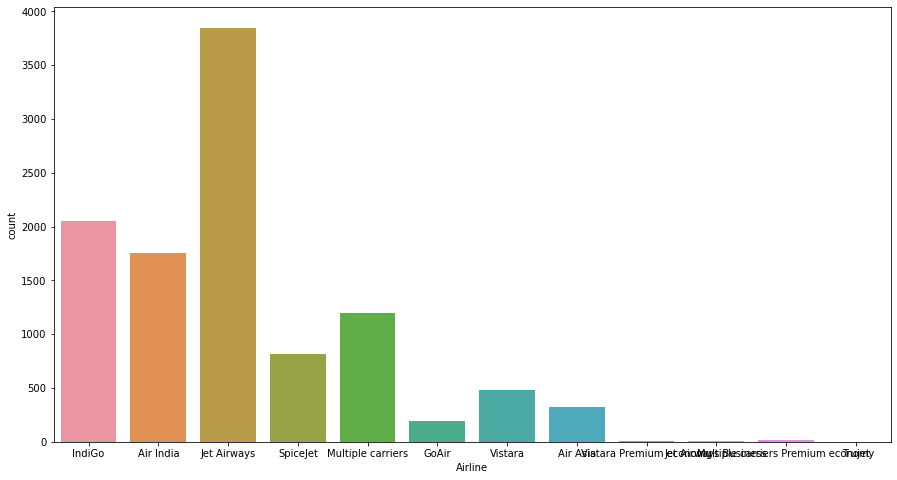

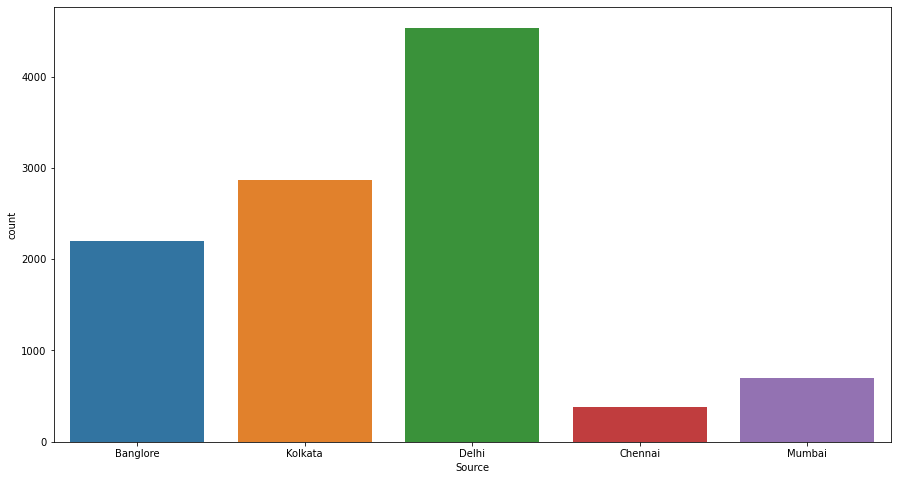

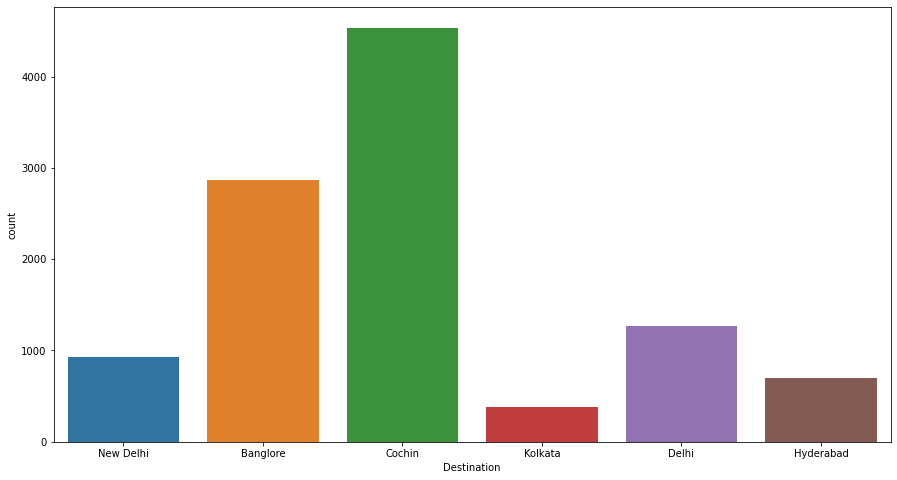

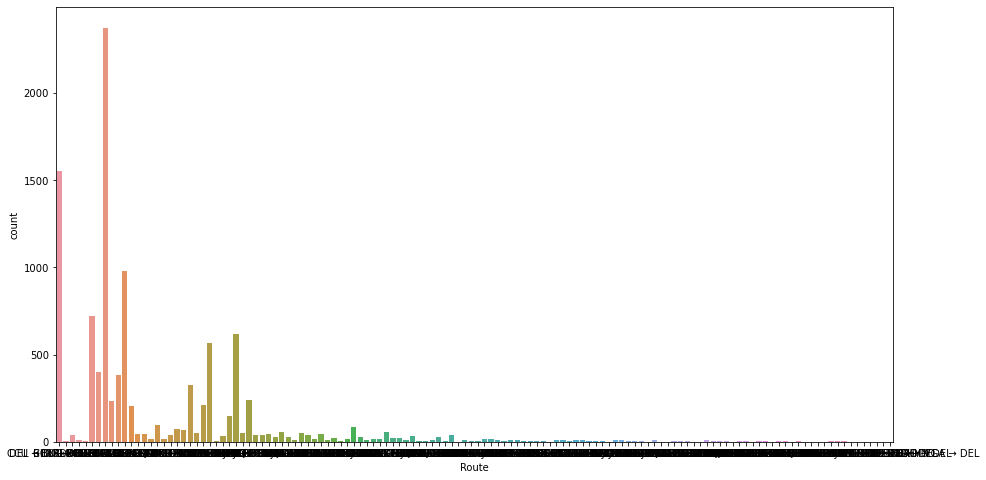

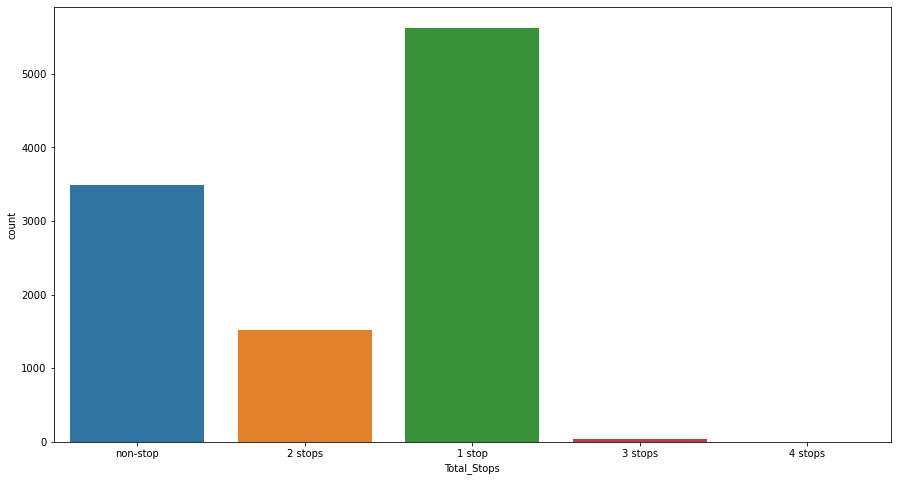

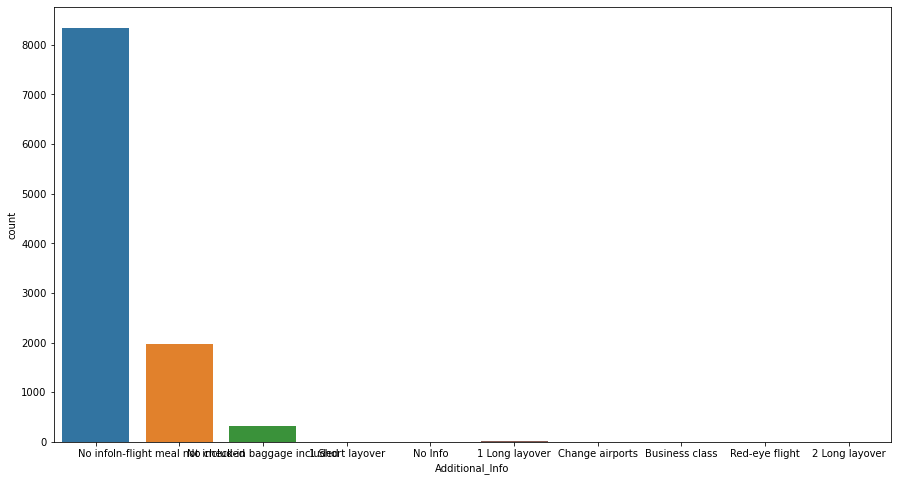

In [34]:
for col in df_cat.columns:
    plt.figure(figsize=(15,8))
    sns.countplot(df_cat[col])
    plt.show()
    

In [35]:
df.describe(include='object')

,Airline,Source,Destination,Route,Total_Stops,Additional_Info
count,10682,10682,10682,10682,10682,10682
unique,12,5,6,128,5,10
top,Jet Airways,Delhi,Cochin,DEL → BOM → COK,1 stop,No info
freq,3849,4536,4536,2376,5625,8344


* we can see Route variable has 128 unique values. Let's check the values first.

In [36]:
df.Route.unique()[:10]

array(['BLR → DEL', 'CCU → IXR → BBI → BLR', 'DEL → LKO → BOM → COK',
       'CCU → NAG → BLR', 'BLR → NAG → DEL', 'CCU → BLR',
       'BLR → BOM → DEL', 'DEL → BOM → COK', 'DEL → BLR → COK',
       'MAA → CCU'], dtype=object)

* We can see this relates to the source and destination via or non-via route of a journey that does bot contribute much for prediction.
* we can simply drop this variable.

In [37]:
df.drop('Route',axis=1,inplace=True)

In [38]:
df.head()

,Airline,Source,Destination,Total_Stops,Additional_Info,Price,Journey_day,Journey_month,Dep_hour,Dep_min,Arrival_hour,Arrival_min,Duration_hours,Duration_mins
0,IndiGo,Banglore,New Delhi,non-stop,No info,3897,24,3,22,20,1,10,2,50
1,Air India,Kolkata,Banglore,2 stops,No info,7662,1,5,5,50,13,15,7,25
2,Jet Airways,Delhi,Cochin,2 stops,No info,13882,9,6,9,25,4,25,19,0
3,IndiGo,Kolkata,Banglore,1 stop,No info,6218,12,5,18,5,23,30,5,25
4,IndiGo,Banglore,New Delhi,1 stop,No info,13302,1,3,16,50,21,35,4,45


* Let's Encode other categorical variables based on their type.

In [39]:
df.describe(include='object')

,Airline,Source,Destination,Total_Stops,Additional_Info
count,10682,10682,10682,10682,10682
unique,12,5,6,5,10
top,Jet Airways,Delhi,Cochin,1 stop,No info
freq,3849,4536,4536,5625,8344


In [40]:
df.Airline.unique()

array(['IndiGo', 'Air India', 'Jet Airways', 'SpiceJet',
       'Multiple carriers', 'GoAir', 'Vistara', 'Air Asia',
       'Vistara Premium economy', 'Jet Airways Business',
       'Multiple carriers Premium economy', 'Trujet'], dtype=object)

In [41]:
df.Total_Stops.unique()

array(['non-stop', '2 stops', '1 stop', '3 stops', '4 stops'],
      dtype=object)

* We can see Total_Stop is Ordinal type. So we can simply use Ordinal encoding.

In [42]:
df.replace({"non-stop": 0, "1 stop": 1, "2 stops": 2, "3 stops": 3, "4 stops": 4}, inplace = True)


In [43]:
df.describe(include='object')

,Airline,Source,Destination,Additional_Info
count,10682,10682,10682,10682
unique,12,5,6,10
top,Jet Airways,Delhi,Cochin,No info
freq,3849,4536,4536,8344


In [44]:
df_cat = df.select_dtypes(include='object')

In [45]:
for col in df_cat.columns:
    print('Columns:',col,'----','Unique_Values:',df[col].unique(),'\n')

Columns: Airline ---- Unique_Values: ['IndiGo' 'Air India' 'Jet Airways' 'SpiceJet' 'Multiple carriers' 'GoAir'
 'Vistara' 'Air Asia' 'Vistara Premium economy' 'Jet Airways Business'
 'Multiple carriers Premium economy' 'Trujet'] 

Columns: Source ---- Unique_Values: ['Banglore' 'Kolkata' 'Delhi' 'Chennai' 'Mumbai'] 

Columns: Destination ---- Unique_Values: ['New Delhi' 'Banglore' 'Cochin' 'Kolkata' 'Delhi' 'Hyderabad'] 

Columns: Additional_Info ---- Unique_Values: ['No info' 'In-flight meal not included' 'No check-in baggage included'
 '1 Short layover' 'No Info' '1 Long layover' 'Change airports'
 'Business class' 'Red-eye flight' '2 Long layover'] 



* We can see in the additional info column, 'No info' is repeated twice and should be considered once .Let's deal with that.

In [46]:
df['Additional_Info'].replace({"No info": 'No Info'}, inplace = True)

In [47]:
for col in df_cat.columns:
    print('Columns:',col,'----','Unique_Values:',df[col].unique(),'\n')

Columns: Airline ---- Unique_Values: ['IndiGo' 'Air India' 'Jet Airways' 'SpiceJet' 'Multiple carriers' 'GoAir'
 'Vistara' 'Air Asia' 'Vistara Premium economy' 'Jet Airways Business'
 'Multiple carriers Premium economy' 'Trujet'] 

Columns: Source ---- Unique_Values: ['Banglore' 'Kolkata' 'Delhi' 'Chennai' 'Mumbai'] 

Columns: Destination ---- Unique_Values: ['New Delhi' 'Banglore' 'Cochin' 'Kolkata' 'Delhi' 'Hyderabad'] 

Columns: Additional_Info ---- Unique_Values: ['No Info' 'In-flight meal not included' 'No check-in baggage included'
 '1 Short layover' '1 Long layover' 'Change airports' 'Business class'
 'Red-eye flight' '2 Long layover'] 



In [48]:
df.describe(include='object')

,Airline,Source,Destination,Additional_Info
count,10682,10682,10682,10682
unique,12,5,6,9
top,Jet Airways,Delhi,Cochin,No Info
freq,3849,4536,4536,8347


* Now we have non-duplicate unique values in the categorical variables of dataframe.
* As they do not posses any order , we can perform one hot encoding.

In [49]:
df.head()

,Airline,Source,Destination,Total_Stops,Additional_Info,Price,Journey_day,Journey_month,Dep_hour,Dep_min,Arrival_hour,Arrival_min,Duration_hours,Duration_mins
0,IndiGo,Banglore,New Delhi,0,No Info,3897,24,3,22,20,1,10,2,50
1,Air India,Kolkata,Banglore,2,No Info,7662,1,5,5,50,13,15,7,25
2,Jet Airways,Delhi,Cochin,2,No Info,13882,9,6,9,25,4,25,19,0
3,IndiGo,Kolkata,Banglore,1,No Info,6218,12,5,18,5,23,30,5,25
4,IndiGo,Banglore,New Delhi,1,No Info,13302,1,3,16,50,21,35,4,45


In [50]:
df = pd.get_dummies(df,drop_first=True)

In [51]:
df.head()

,Total_Stops,Price,Journey_day,Journey_month,Dep_hour,Dep_min,Arrival_hour,Arrival_min,Duration_hours,Duration_mins,...,Destination_Kolkata,Destination_New Delhi,Additional_Info_1 Short layover,Additional_Info_2 Long layover,Additional_Info_Business class,Additional_Info_Change airports,Additional_Info_In-flight meal not included,Additional_Info_No Info,Additional_Info_No check-in baggage included,Additional_Info_Red-eye flight
0,0,3897,24,3,22,20,1,10,2,50,...,0,1,0,0,0,0,0,1,0,0
1,2,7662,1,5,5,50,13,15,7,25,...,0,0,0,0,0,0,0,1,0,0
2,2,13882,9,6,9,25,4,25,19,0,...,0,0,0,0,0,0,0,1,0,0
3,1,6218,12,5,18,5,23,30,5,25,...,0,0,0,0,0,0,0,1,0,0
4,1,13302,1,3,16,50,21,35,4,45,...,0,1,0,0,0,0,0,1,0,0


In [52]:
df.shape

(10682, 38)

So, we have 38 variables in the final dataframe including the dependent variable ‘Price’. There are only 37 variables for training.

## Handling Numerical Data.

<AxesSubplot:xlabel='Price', ylabel='Density'>

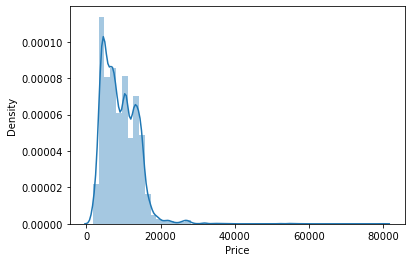

In [53]:
sns.distplot(df.Price)

<AxesSubplot:xlabel='Price'>

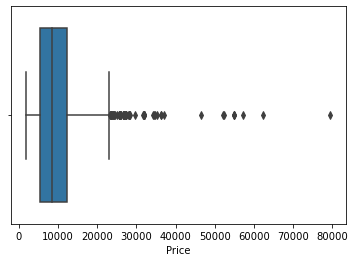

In [54]:
sns.boxplot(df.Price)

## Model Building

* Prior to model building we split data into train and test set in 4:1 ratio with fixed random state for reproducability.

In [55]:
X=df.drop('Price',axis=1)
y=df['Price']

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 1)

In [56]:
X_train.shape,X_test.shape,y_train.shape,y_test.shape

((8545, 37), (2137, 37), (8545,), (2137,))

* lets check if train and test data represents the  overall data or not.

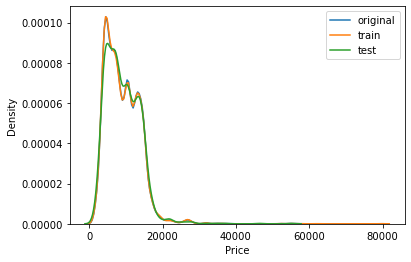

In [57]:
sns.distplot(df.Price,label='original',hist=False)
sns.distplot(y_train,label='train',hist=False)
sns.distplot(y_test,label='test',hist=False)
plt.legend()
plt.show()

* As we can see all data distribution is similar post split into train and test. So ,lets proceed with building the model.

* Here we go ahead with RandomForestRegressor as estimator.

In [58]:
from sklearn.ensemble import RandomForestRegressor

In [59]:
rf = RandomForestRegressor(random_state=1)

In [60]:
rf.fit(X_train,y_train)

RandomForestRegressor(random_state=1)

In [61]:
y_pred_test = rf.predict(X_test)
y_pred_train = rf.predict(X_train)


In [62]:
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error

Train Scores

In [63]:
print('Train R2: ',r2_score(y_train,y_pred_train))
print('Train MAE: ',mean_absolute_error(y_train,y_pred_train))
print('Train RMSE: ',mean_squared_error(y_train,y_pred_train,squared=False))

Train R2:  0.982269780831637
Train MAE:  262.3820345722673
Train RMSE:  616.7208717098042


Test Scores

In [64]:
print('Test R2: ',r2_score(y_test,y_pred_test))
print('Test MAE: ',mean_absolute_error(y_test,y_pred_test))
print('Test RMSE: ',mean_squared_error(y_test,y_pred_test,squared=False))

Test R2:  0.9024839520219393
Test MAE:  657.3843926863054
Test RMSE:  1414.2565078529096


Feature Selection : Sequential Feature Selector

In [65]:
from mlxtend.feature_selection import SequentialFeatureSelector as sfs

In [66]:
X_train.shape

(8545, 37)

In [67]:
rf = RandomForestRegressor(random_state=1)

sfs1= sfs(rf, k_features='best', scoring='r2',cv=3, verbose=2 )

sfs1.fit(X_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  37 out of  37 | elapsed:   13.2s finished

[2021-09-13 14:12:52] Features: 1/37 -- score: 0.41979596860690754[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  36 out of  36 | elapsed:   20.6s finished

[2021-09-13 14:13:12] Features: 2/37 -- score: 0.4808870161216956[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  35 out of  35 | elapsed:   22.8s finished

[2021-09-13 14:13:35] Features: 3/37 -- score: 0.5577095785975427[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 

[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:   45.6s finished

[2021-09-13 14:40:53] Features: 28/37 -- score: 0.8735781729706159[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:   41.5s finished

[2021-09-13 14:41:35] Features: 29/37 -- score: 0.8742835430268802[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:   37.6s finished

[2021-09-13 14:42:12] Features: 30/37 -- score: 0.8741377945119754[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:   32.9s finished

[2021-09-13 14:42:46] Features: 31/

SequentialFeatureSelector(cv=3, estimator=RandomForestRegressor(random_state=1),
                          k_features='best', scoring='r2', verbose=2)

In [68]:
len(sfs1.k_feature_names_)

29

In [69]:
sig_feat = list(sfs1.k_feature_names_)
sig_feat

['Total_Stops',
 'Journey_day',
 'Journey_month',
 'Dep_hour',
 'Dep_min',
 'Arrival_hour',
 'Arrival_min',
 'Duration_hours',
 'Duration_mins',
 'Airline_Air India',
 'Airline_GoAir',
 'Airline_IndiGo',
 'Airline_Jet Airways',
 'Airline_Jet Airways Business',
 'Airline_Multiple carriers',
 'Airline_Multiple carriers Premium economy',
 'Airline_Vistara',
 'Airline_Vistara Premium economy',
 'Source_Chennai',
 'Source_Delhi',
 'Source_Kolkata',
 'Source_Mumbai',
 'Destination_Delhi',
 'Destination_Hyderabad',
 'Destination_Kolkata',
 'Destination_New Delhi',
 'Additional_Info_2 Long layover',
 'Additional_Info_In-flight meal not included',
 'Additional_Info_No check-in baggage included']

* Using Sequential feature selector we have extracted 16 best features, that we will use and retrain our model.

In [70]:
X_train_new = X_train[sig_feat]
X_test_new = X_test[sig_feat]



In [71]:
rf2 = RandomForestRegressor(random_state=1)

rf2.fit(X_train_new,y_train)

y_pred_test = rf2.predict(X_test_new)
y_pred_train = rf2.predict(X_train_new)


Train Scores

In [72]:
print('Train R2: ',r2_score(y_train,y_pred_train))
print('Train MAE: ',mean_absolute_error(y_train,y_pred_train))
print('Train RMSE: ',mean_squared_error(y_train,y_pred_train,squared=False))

Train R2:  0.9824546126760129
Train MAE:  261.22416775513676
Train RMSE:  613.497891493953


Test Scores

In [73]:
print('Test R2: ',r2_score(y_test,y_pred_test))
print('Test MAE: ',mean_absolute_error(y_test,y_pred_test))
print('Test RMSE: ',mean_squared_error(y_test,y_pred_test,squared=False))

Test R2:  0.8982175481491673
Test MAE:  658.6969178383878
Test RMSE:  1444.8627474605473


Selected Features for Final Model

In [74]:
X_train_new.columns.to_list()

['Total_Stops',
 'Journey_day',
 'Journey_month',
 'Dep_hour',
 'Dep_min',
 'Arrival_hour',
 'Arrival_min',
 'Duration_hours',
 'Duration_mins',
 'Airline_Air India',
 'Airline_GoAir',
 'Airline_IndiGo',
 'Airline_Jet Airways',
 'Airline_Jet Airways Business',
 'Airline_Multiple carriers',
 'Airline_Multiple carriers Premium economy',
 'Airline_Vistara',
 'Airline_Vistara Premium economy',
 'Source_Chennai',
 'Source_Delhi',
 'Source_Kolkata',
 'Source_Mumbai',
 'Destination_Delhi',
 'Destination_Hyderabad',
 'Destination_Kolkata',
 'Destination_New Delhi',
 'Additional_Info_2 Long layover',
 'Additional_Info_In-flight meal not included',
 'Additional_Info_No check-in baggage included']

In [75]:
X_train_new.head(5)

,Total_Stops,Journey_day,Journey_month,Dep_hour,Dep_min,Arrival_hour,Arrival_min,Duration_hours,Duration_mins,Airline_Air India,...,Source_Delhi,Source_Kolkata,Source_Mumbai,Destination_Delhi,Destination_Hyderabad,Destination_Kolkata,Destination_New Delhi,Additional_Info_2 Long layover,Additional_Info_In-flight meal not included,Additional_Info_No check-in baggage included
8201,1,24,4,20,25,1,30,5,5,0,...,1,0,0,0,0,0,0,0,0,0
5398,1,27,6,12,50,21,0,8,10,0,...,1,0,0,0,0,0,0,0,1,0
9277,1,9,5,16,30,23,35,7,5,0,...,0,1,0,0,0,0,0,0,0,0
1595,1,18,5,20,40,9,25,12,45,1,...,1,0,0,0,0,0,0,0,0,0
8172,1,24,5,17,30,20,25,26,55,1,...,0,1,0,0,0,0,0,0,0,0


#### Exporting The Model file Using Pickle

In [76]:
import pickle

file = './Model/rf.pkl'
with open(file, 'wb') as f:
    pickle.dump(rf2, f)

#### Testing the Model with dummy data

In [77]:
file = './Model/rf.pkl'
with open(file, 'rb') as f:
    model = pickle.load(f)

In [78]:
test_val=[[0,
  9,
  4,
  21,
  5,
  23,
  55,
  2,
  50,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0]]

In [79]:
predictions=model.predict(test_val)

In [83]:
predictions[0]

5134.41